In [93]:
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable
plt.style.use('/home/pgrams/latex-cm.mplstyle')

In [94]:
min_temp=20.2
max_temp=38.2
image_path = 'images/chargefem1_gs.jpg'

img = Image.open(image_path).convert('L')
pixel_array = np.array(img)/255.0

# map to user defined temperature range
temp_data = min_temp + (pixel_array * (max_temp - min_temp)) + 273.15

plt.figure(figsize=(10, 8))

# plot in greyscale
ax = plt.subplot(1, 1, 1)
ax.set_aspect('equal', adjustable='box')
plt.xlim(0, img.size[0]-100)
plt.ylim(img.size[1], 0)
plt.title('Charge FEM Thermal Image', loc='center')
plt.xlabel("Pixels")
plt.ylabel("Pixels")

# find height of board visually to determine pixel scale
top = 28
bottom = 468
left = 135
right = 475
plt.axhline(y=top, color='white', linewidth=0.7)
plt.axhline(y=bottom, color='white', linewidth=0.7)
plt.axvline(x=left, color='white', linewidth=0.7)
plt.axvline(x=right, color='white', linewidth=0.7)

# board height in mm:
board_height_mm = 363.47

# board width in mm:
board_width_mm = 280.0

# pixel scale:
pixel_scale = (board_height_mm)/(bottom - top)   # mm/px
plt.text(8, top-6, f'y={top} px', color='white', fontsize=12)
plt.text(8, bottom-6, f'y={bottom} px', color='white', fontsize=12)
plt.text(8, top+40, f'Board height:\n{board_height_mm:.2f} mm', color='white', fontsize=14, bbox=dict(facecolor='white', alpha=0.5, edgecolor='none'), antialiased=True)
plt.text(8, top+100, f'Pixel scale:\n {board_height_mm} mm/{bottom}-{top} px \n = {pixel_scale:.2f} mm/px', color='white', fontsize=14, bbox=dict(facecolor='white', alpha=0.5, edgecolor='none'), antialiased=True)

img_plot = ax.imshow(temp_data, cmap='gray')

# make colorbar height match axes height
from mpl_toolkits.axes_grid1 import make_axes_locatable
divider = make_axes_locatable(ax)
cax = divider.append_axes('right', size='5%', pad=0.05)
cbar = plt.colorbar(img_plot, cax=cax)
cbar.set_label('Temperature (K)', rotation=270, labelpad=20)


plt.tight_layout()
plt.show()

FileNotFoundError: [Errno 2] No such file or directory: 'images/chargefem1_gs.jpg'

In [ ]:
# --- Calculate Laplacian with respect to real dimensions ---

Nx = temp_data.shape[1]  # number of columns (width)
Ny = temp_data.shape[0]  # number of rows (height)

# find pixel size in millimeters
dx = 1/pixel_scale # mm/px
dy = 1/pixel_scale # mm/px

# 4. Calculate the second partial derivatives using finite differences
#    This replaces the cv.Sobel operator with a discrete calculation.

# Initialize arrays for the second derivatives
gxx = np.zeros_like(temp_data)
gyy = np.zeros_like(temp_data)

# Calculate second derivative in x-direction for interior points
gxx[:, 1:-1] = temp_data[:, 2:] - 2 * temp_data[:, 1:-1] + temp_data[:, :-2]

# Calculate second derivative in y-direction for interior points
gyy[1:-1, :] = temp_data[2:, :] - 2 * temp_data[1:-1, :] + temp_data[:-2, :]

# 5. Scale derivatives by pixel size squared and sum them to get the Laplacian
laplacian_scaled = (gxx / (dx**2)) + (gyy / (dy**2))


# --- Plotting the Scaled Laplacian ---

plt.figure(figsize=(10, 8))
ax = plt.subplot(1, 1, 1)
ax.set_aspect('equal', adjustable='box')

# Use 'extent' to map the pixels to real-world coordinates
laplacian_plot = ax.imshow(laplacian_scaled, cmap='gray', extent=[0, Nx*dx, Ny*dy, 0])
plt.xlim(0, (Nx-100)*dx)
plt.xlabel("Width (mm)")
plt.ylabel("Height (mm)")


divider = make_axes_locatable(ax)
cax = divider.append_axes('right', size='5%', pad=0.05)
cbar = plt.colorbar(laplacian_plot, cax=cax)
cbar.set_label('Laplacian Magnitude', rotation=270, labelpad=20)

plt.tight_layout()
plt.show()


NameError: name 'temp_data' is not defined

In [95]:
def board_power(
    image_path: str,
    temp_range_c: list,
    board_dims_mm: list,
    y_bounds_px: list,
    x_bounds_px: list,
    plot_title: str = '',
    include_convection: bool = True,
    emissivity: float = 0.95,
    h_convection: float = 10.0,
    scale: float = 1.0
):
    """
    Calculates and visualizes the total power dissipated from a circuit board region.

    This function reads a thermal image, maps it to a temperature range, calculates
    the power density from radiation (and optionally convection), and integrates it
    over a specified rectangular region to find the total dissipated power.

    Args:
        image_path (str): Path to the thermal image file.
        temp_range_c (list): A list containing the [min, max] temperature in Celsius.
        board_dims_mm (list): A list of the board's real-world [height, width] in mm.
        y_bounds_px (list): A list of the board's [top, bottom] pixel coordinates.
        x_bounds_px (list): A list of the board's [left, right] pixel coordinates.
        plot_title (str, optional): The title for the output plot.
                                    Defaults to 'Power Density Map'.
        include_convection (bool, optional): If True, includes convective heat transfer.
                                            Defaults to True.
        emissivity (float, optional): The emissivity of the board surface (0 to 1).
                                      Defaults to 0.95.
        h_convection (float, optional): The convective heat transfer coefficient in W/(m^2*K).
                                        Defaults to 10.0 (natural convection).

    Returns:
        float: The total calculated power dissipated from the region in Watts.
    """
    # 1. Unpack input parameters for clarity
    min_temp_c, max_temp_c = temp_range_c
    board_height_mm, board_width_mm = board_dims_mm
    top_px, bottom_px = y_bounds_px
    left_px, right_px = x_bounds_px

    # 2. Load Image and Create Temperature Map in Kelvin
    img = Image.open(image_path).convert('L')
    pixel_greyscale = np.array(img) / 255.0
    temp_map_k = min_temp_c + (pixel_greyscale * (max_temp_c - min_temp_c)) + 273.15

    # 3. Define Physical Constants
    T_ambient_k = 20.0 + 273.15  # Ambient temperature (20 C) in Kelvin
    sigma_sb = 5.67e-8           # Stefan-Boltzmann constant in W/(m^2*K^4)

    # 4. Calculate Pixel Scale and Area
    px_delta_y = bottom_px - top_px
    px_delta_x = right_px - left_px

    scale_y_mm_per_px = board_height_mm / px_delta_y
    scale_x_mm_per_px = board_width_mm / px_delta_x
    avg_scale_mm_per_px = (scale_y_mm_per_px + scale_x_mm_per_px) / 2.0

    print("--- Pixel Scale Calculation ---")
    print(f"Y-axis scale: {scale_y_mm_per_px:.4f} mm/px")
    print(f"X-axis scale: {scale_x_mm_per_px:.4f} mm/px")
    print(f"Averaged scale: {avg_scale_mm_per_px:.4f} mm/px")

    pixel_area_m2 = (avg_scale_mm_per_px ** 2) / (1000.0 ** 2)

    # 5. Calculate Power Density Map (W/m^2)
    power_density_rad_w_m2 = emissivity * sigma_sb * (temp_map_k**4 - T_ambient_k**4)
    total_power_density_w_m2 = power_density_rad_w_m2

    if include_convection:
        power_density_conv_w_m2 = h_convection * (temp_map_k - T_ambient_k)
        total_power_density_w_m2 += power_density_conv_w_m2

    # Apply scaling
    total_power_density_w_m2 *= scale

    # 6. Integrate Power Over the Region of Interest (ROI)
    roi_power_density_w_m2 = total_power_density_w_m2[top_px:bottom_px, left_px:right_px]
    total_power_watts = np.sum(roi_power_density_w_m2) * pixel_area_m2

    # 7. Print Final Results
    print("\n--- Model Parameters ---")
    print(f"Emissivity (ε): {emissivity}")
    print(f"Convection included: {include_convection}")
    if include_convection:
        print(f"Convective Coefficient (h): {h_convection} W/(m^2*K)")
    
    print("\n--- Power Calculation Results ---")
    print(f"Region of Interest (pixels): Y=({top_px}, {bottom_px}), X=({left_px}, {right_px})")
    print("-" * 35)
    print(f"Total Integrated Power: {total_power_watts:.4f} Watts")
    print("-" * 35)

    # 8. Plotting
    if plot_title:
        plt.figure(figsize=(12, 8))
        ax = plt.subplot(1, 1, 1)
        ax.set_aspect('equal', adjustable='box')
        plt.title(f'Power Density: {plot_title}', loc='center', fontsize=16)
        plt.xlabel("Pixels", fontsize=12)
        plt.ylabel("Pixels", fontsize=12)
        plt.xlim(0, img.size[0]-75)
        plt.ylim(img.size[1], 0)

        # Convert power density to W/mm^2 for plotting
        power_density_for_plot_w_mm2 = total_power_density_w_m2 / (1000.0**2)

        power_plot = ax.imshow(power_density_for_plot_w_mm2, cmap='inferno')

        rect = plt.Rectangle((left_px, top_px), px_delta_x, px_delta_y,
                            linewidth=1, edgecolor='white', ls='--', facecolor='none')
        ax.add_patch(rect)

        # Add a text box with the result, including pixel scaled
        text_str = (
            f"Pixel Scale: {avg_scale_mm_per_px:.3f} mm/px\n"
            f"Integrated Power: {total_power_watts:.2f} W"
        )
        
        plt.text(20, 455, text_str, color='white', fontsize=12,
                bbox=dict(facecolor='black', alpha=0.7))

        divider = make_axes_locatable(ax)
        cax = divider.append_axes('right', size='5%', pad=0.1)
        cbar = plt.colorbar(power_plot, cax=cax)
        cbar.set_label('Power Density (W/mm²)', rotation=270, labelpad=20, fontsize=12)
        
        plt.tight_layout()
        plt.show()

    return total_power_watts


--- Pixel Scale Calculation ---
Y-axis scale: 0.9344 mm/px
X-axis scale: 0.9032 mm/px
Averaged scale: 0.9188 mm/px

--- Model Parameters ---
Emissivity (ε): 0.94
Convection included: False

--- Power Calculation Results ---
Region of Interest (pixels): Y=(60, 449), X=(175, 485)
-----------------------------------
Total Integrated Power: 5.2704 Watts
-----------------------------------


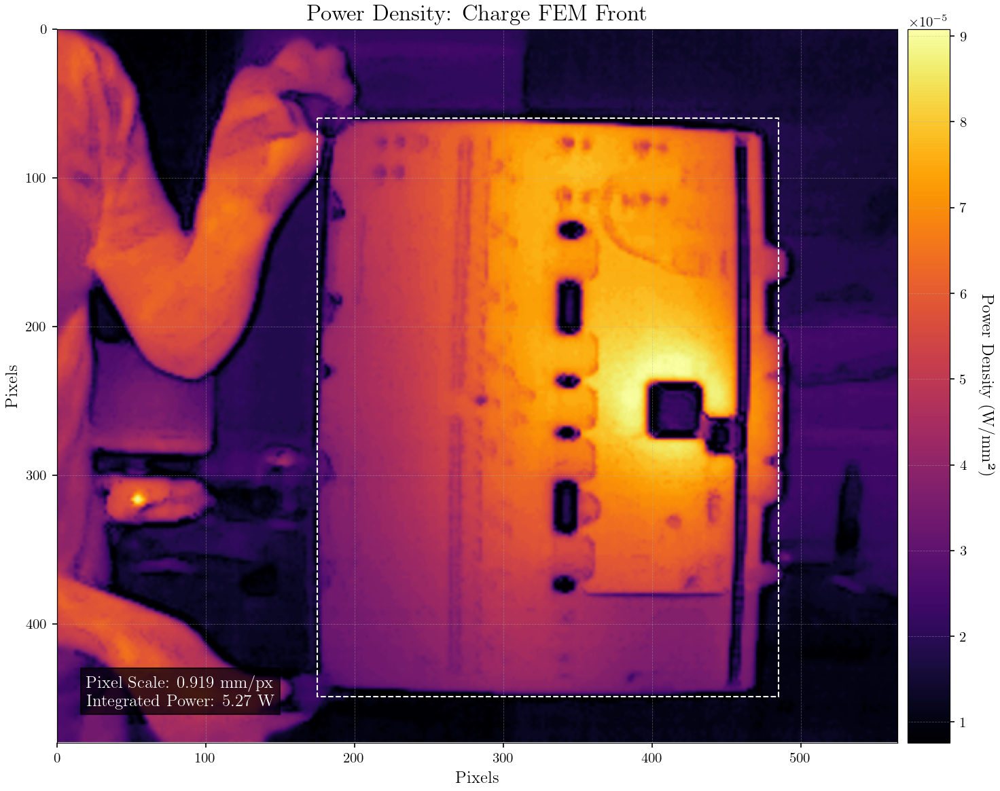

In [96]:
# --- Define Input Parameters ---
IMAGE_FILE = 'images/8.19.2025/chargefem_front.jpg'
TEMP_RANGE_C = [21.4, 36.2]
BOARD_DIMS_MM = [363.47, 280.0]  # [height, width]
Y_BOUNDS_PX = [60, 449]          # [top, bottom]
X_BOUNDS_PX = [175, 485]         # [left, right]
PLOT_TITLE = 'Charge FEM Front'
EMISSIVITY = 0.94
CONV = 10


# --- Run the Analysis ---
chargefem_front_power = board_power(
    image_path=IMAGE_FILE,
    temp_range_c=TEMP_RANGE_C,
    board_dims_mm=BOARD_DIMS_MM,
    y_bounds_px=Y_BOUNDS_PX,
    x_bounds_px=X_BOUNDS_PX,
    plot_title=PLOT_TITLE,
    emissivity=EMISSIVITY,
    include_convection=False,
    h_convection=CONV
)

--- Pixel Scale Calculation ---
Y-axis scale: 0.8822 mm/px
X-axis scale: 0.8284 mm/px
Averaged scale: 0.8553 mm/px

--- Model Parameters ---
Emissivity (ε): 0.94
Convection included: False

--- Power Calculation Results ---
Region of Interest (pixels): Y=(44, 456), X=(142, 480)
-----------------------------------
Total Integrated Power: 6.1237 Watts
-----------------------------------


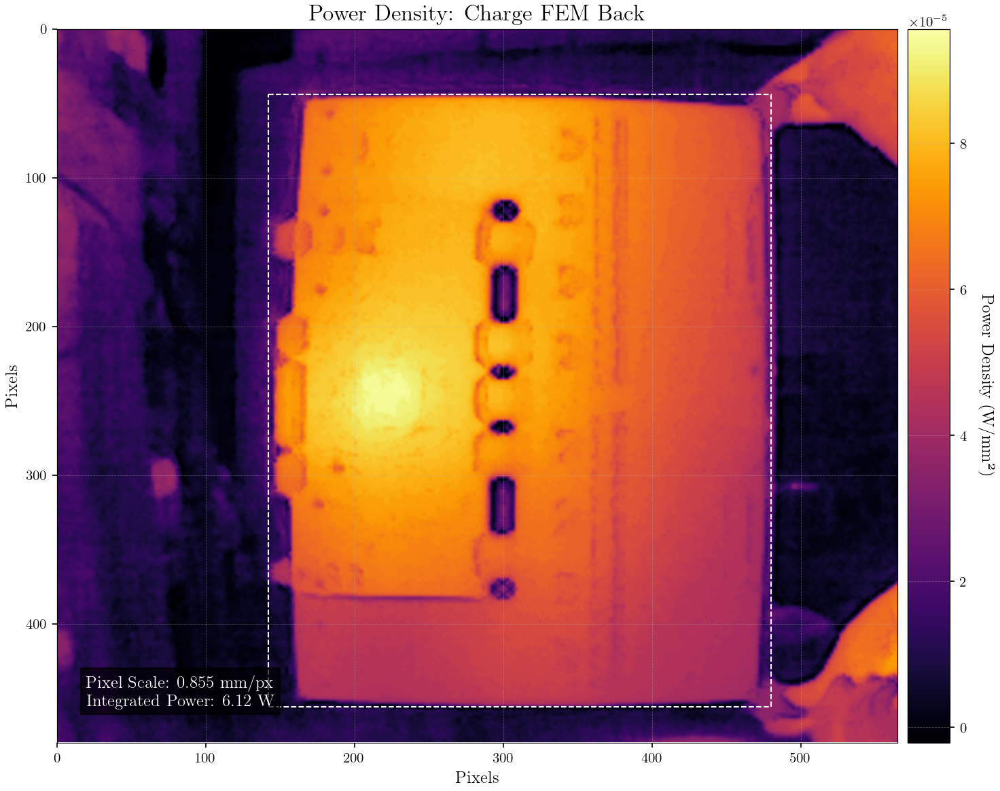

Total Charge FEM Power:  11.394073271907493 Watts


In [97]:
# --- Define Input Parameters ---
IMAGE_FILE = 'images/8.19.2025/chargefem_back.jpg'
TEMP_RANGE_C = [19.6, 37.0] # Celsius
BOARD_DIMS_MM = [363.47, 280.0]  # [height, width]
Y_BOUNDS_PX = [44, 456]          # [top, bottom]
X_BOUNDS_PX = [142, 480]         # [left, right]
PLOT_TITLE = 'Charge FEM Back'
EMISSIVITY = 0.94
CONV = 10

# --- Run the Analysis ---
chargefem_back_power = board_power(
    image_path=IMAGE_FILE,
    temp_range_c=TEMP_RANGE_C,
    board_dims_mm=BOARD_DIMS_MM,
    y_bounds_px=Y_BOUNDS_PX,
    x_bounds_px=X_BOUNDS_PX,
    plot_title=PLOT_TITLE,
    emissivity=EMISSIVITY,
    include_convection=False,
    h_convection=CONV
)

chargefem_power = chargefem_front_power + chargefem_back_power
print("Total Charge FEM Power: ", chargefem_power, 'Watts')

--- Pixel Scale Calculation ---
Y-axis scale: 0.6838 mm/px
X-axis scale: 0.6747 mm/px
Averaged scale: 0.6793 mm/px

--- Model Parameters ---
Emissivity (ε): 0.94
Convection included: False

--- Power Calculation Results ---
Region of Interest (pixels): Y=(70, 410), X=(110, 525)
-----------------------------------
Total Integrated Power: 2.2771 Watts
-----------------------------------


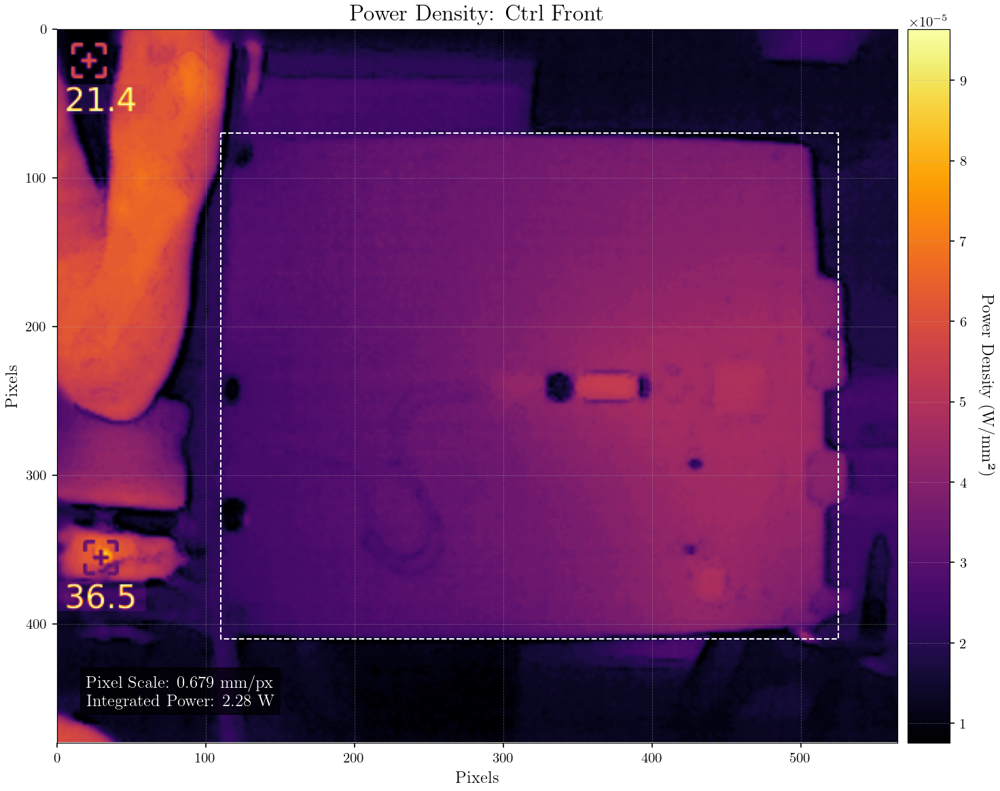

In [98]:
# --- Define Input Parameters ---
IMAGE_FILE = 'images/8.19.2025/ctrl_front.jpg'
TEMP_RANGE_C = [21.4, 36.5] # Celsius
BOARD_DIMS_MM = [232.5, 280.0]  # [height, width]
Y_BOUNDS_PX = [70, 410]          # [top, bottom]
X_BOUNDS_PX = [110, 525]         # [left, right]
PLOT_TITLE = 'Ctrl Front'
EMISSIVITY = 0.94
CONV = 10

# --- Run the Analysis ---
ctrl_front_power = board_power(
    image_path=IMAGE_FILE,
    temp_range_c=TEMP_RANGE_C,
    board_dims_mm=BOARD_DIMS_MM,
    y_bounds_px=Y_BOUNDS_PX,
    x_bounds_px=X_BOUNDS_PX,
    plot_title=PLOT_TITLE,
    include_convection=False,
    emissivity=EMISSIVITY,
    h_convection=CONV
)

--- Pixel Scale Calculation ---
Y-axis scale: 0.7334 mm/px
X-axis scale: 0.7467 mm/px
Averaged scale: 0.7401 mm/px

--- Model Parameters ---
Emissivity (ε): 0.94
Convection included: False

--- Power Calculation Results ---
Region of Interest (pixels): Y=(93, 410), X=(80, 455)
-----------------------------------
Total Integrated Power: 1.9364 Watts
-----------------------------------


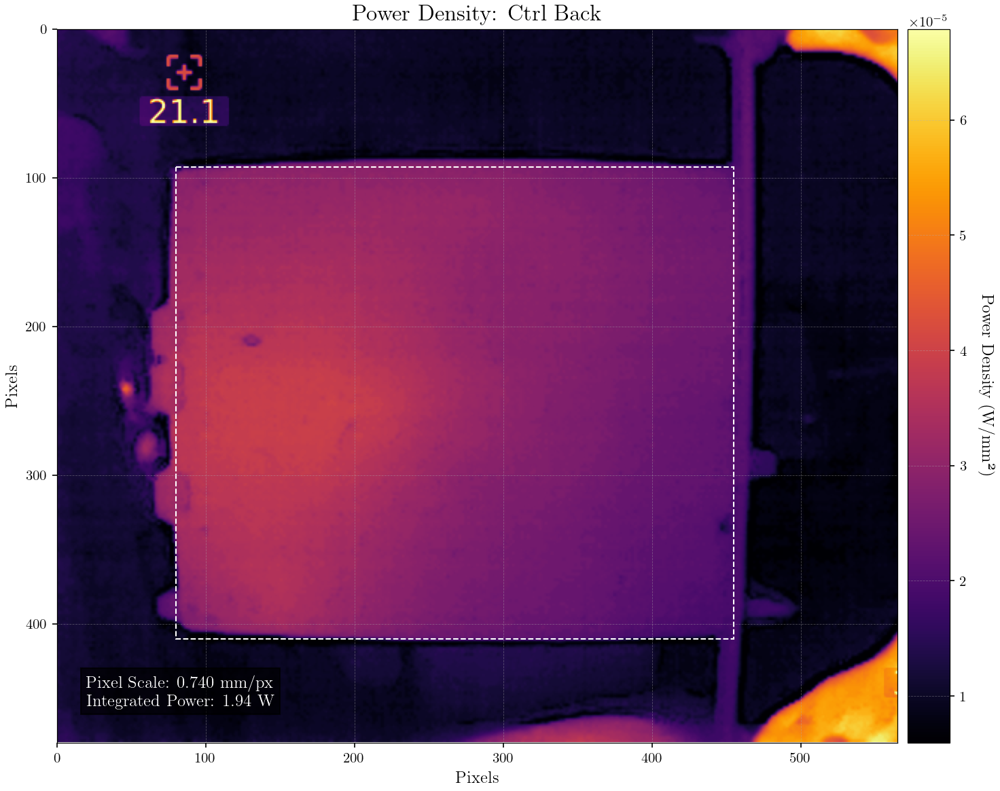

Total Ctrl Power:  4.213581500752014 Watts


In [99]:
# --- Define Input Parameters ---
IMAGE_FILE = 'images/8.19.2025/ctrl_back.jpg'
TEMP_RANGE_C = [21.1, 31.9] # Celsius
BOARD_DIMS_MM = [232.5, 280.0]  # [height, width]
Y_BOUNDS_PX = [93, 410]          # [top, bottom]
X_BOUNDS_PX = [80, 455]         # [left, right]
PLOT_TITLE = 'Ctrl Back'
EMISSIVITY = 0.94
CONV = 10

# --- Run the Analysis ---
ctrl_back_power = board_power(
    image_path=IMAGE_FILE,
    temp_range_c=TEMP_RANGE_C,
    board_dims_mm=BOARD_DIMS_MM,
    y_bounds_px=Y_BOUNDS_PX,
    x_bounds_px=X_BOUNDS_PX,
    plot_title=PLOT_TITLE,
    include_convection=False,
    emissivity=EMISSIVITY,
    h_convection=CONV
)

ctrl_power = ctrl_front_power + ctrl_back_power
print("Total Ctrl Power: ", ctrl_power, 'Watts')

--- Pixel Scale Calculation ---
Y-axis scale: 0.7003 mm/px
X-axis scale: 0.6829 mm/px
Averaged scale: 0.6916 mm/px

--- Model Parameters ---
Emissivity (ε): 0.94
Convection included: False

--- Power Calculation Results ---
Region of Interest (pixels): Y=(88, 420), X=(105, 515)
-----------------------------------
Total Integrated Power: 5.1736 Watts
-----------------------------------


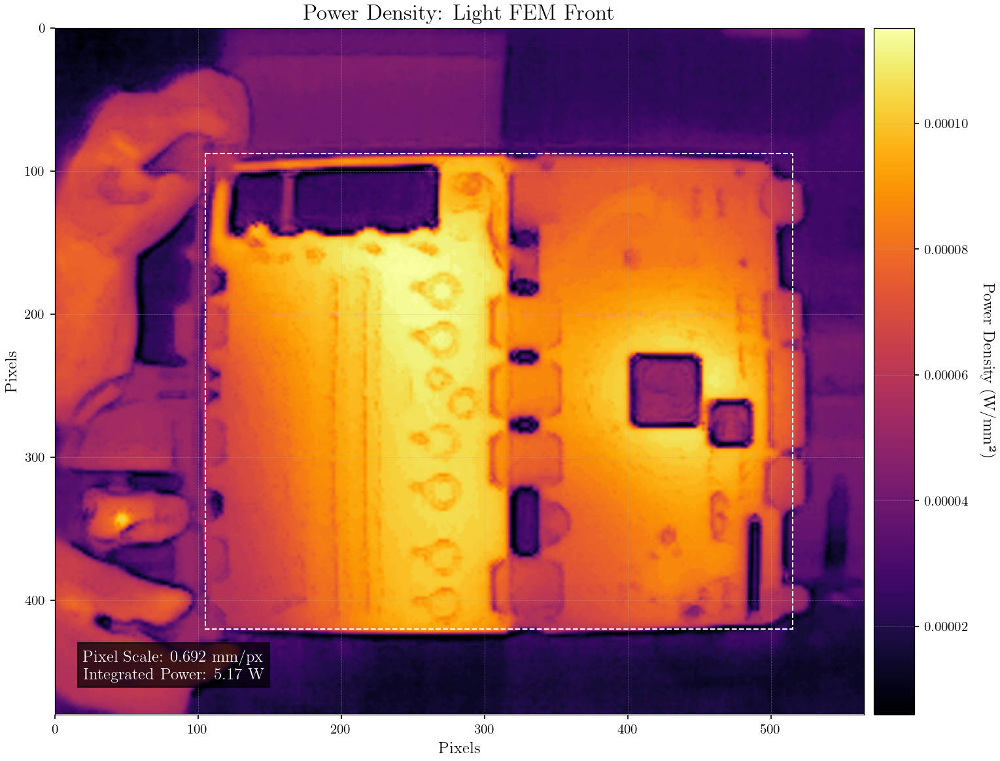

In [100]:
# --- Define Input Parameters ---
IMAGE_FILE = 'images/8.19.2025/lightfem_front.jpg'
TEMP_RANGE_C = [21.1, 40.1] # Celsius
BOARD_DIMS_MM = [232.5, 280.0]  # [height, width]
Y_BOUNDS_PX = [88, 420]          # [top, bottom]
X_BOUNDS_PX = [105, 515]         # [left, right]
PLOT_TITLE = 'Light FEM Front'
EMISSIVITY = 0.94
CONV = 10

# --- Run the Analysis ---
lightfem_front_power = board_power(
    image_path=IMAGE_FILE,
    temp_range_c=TEMP_RANGE_C,
    board_dims_mm=BOARD_DIMS_MM,
    y_bounds_px=Y_BOUNDS_PX,
    x_bounds_px=X_BOUNDS_PX,
    plot_title=PLOT_TITLE,
    include_convection=False,
    emissivity=EMISSIVITY,
    h_convection=CONV
)

--- Pixel Scale Calculation ---
Y-axis scale: 0.6899 mm/px
X-axis scale: 0.6914 mm/px
Averaged scale: 0.6906 mm/px

--- Model Parameters ---
Emissivity (ε): 0.94
Convection included: False

--- Power Calculation Results ---
Region of Interest (pixels): Y=(83, 420), X=(105, 510)
-----------------------------------
Total Integrated Power: 5.3100 Watts
-----------------------------------


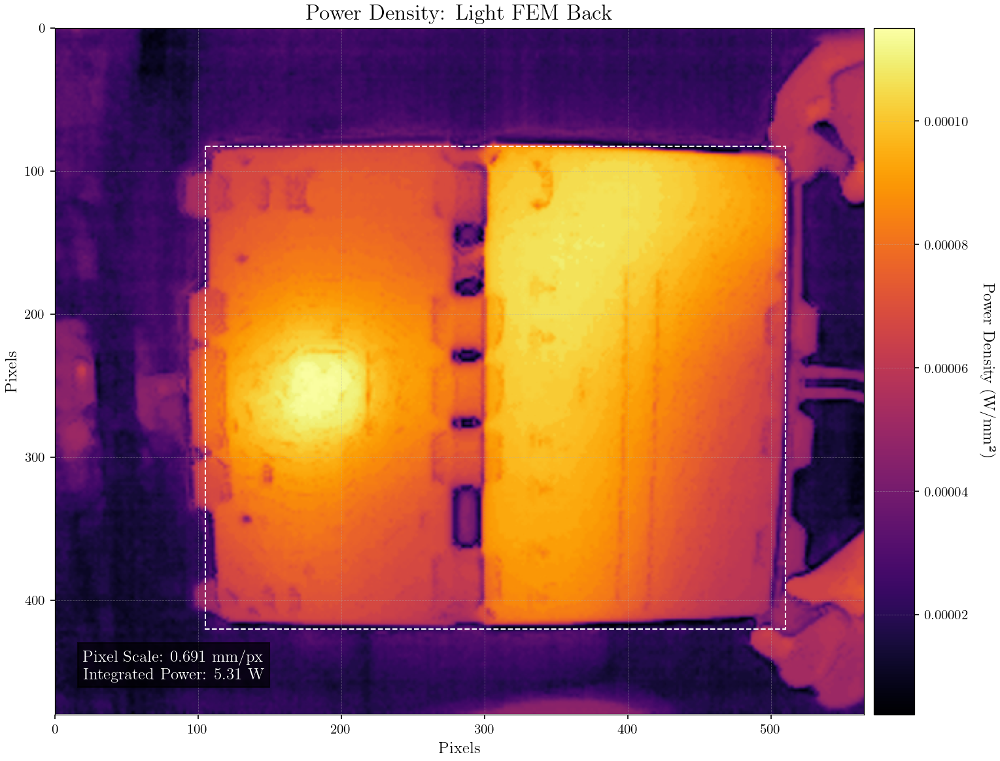

Total Light FEM Power:  10.483599261398105 Watts


In [101]:
# --- Define Input Parameters ---
IMAGE_FILE = 'images/8.19.2025/lightfem_back.jpg'
TEMP_RANGE_C = [20.7, 40.1] # Celsius
BOARD_DIMS_MM = [232.5, 280.0]  # [height, width]
Y_BOUNDS_PX = [83, 420]          # [top, bottom]
X_BOUNDS_PX = [105, 510]         # [left, right]
PLOT_TITLE = 'Light FEM Back'
EMISSIVITY = 0.94
CONV = 10

# --- Run the Analysis ---
lightfem_back_power = board_power(
    image_path=IMAGE_FILE,
    temp_range_c=TEMP_RANGE_C,
    board_dims_mm=BOARD_DIMS_MM,
    y_bounds_px=Y_BOUNDS_PX,
    x_bounds_px=X_BOUNDS_PX,
    plot_title=PLOT_TITLE,
    include_convection=False,
    emissivity=EMISSIVITY,
    h_convection=CONV
)

lightfem_power = lightfem_front_power + lightfem_back_power
print("Total Light FEM Power: ", lightfem_power, 'Watts')

--- Pixel Scale Calculation ---
Y-axis scale: 0.8741 mm/px
X-axis scale: 0.8833 mm/px
Averaged scale: 0.8787 mm/px

--- Model Parameters ---
Emissivity (ε): 0.94
Convection included: False

--- Power Calculation Results ---
Region of Interest (pixels): Y=(154, 420), X=(145, 462)
-----------------------------------
Total Integrated Power: 2.0547 Watts
-----------------------------------


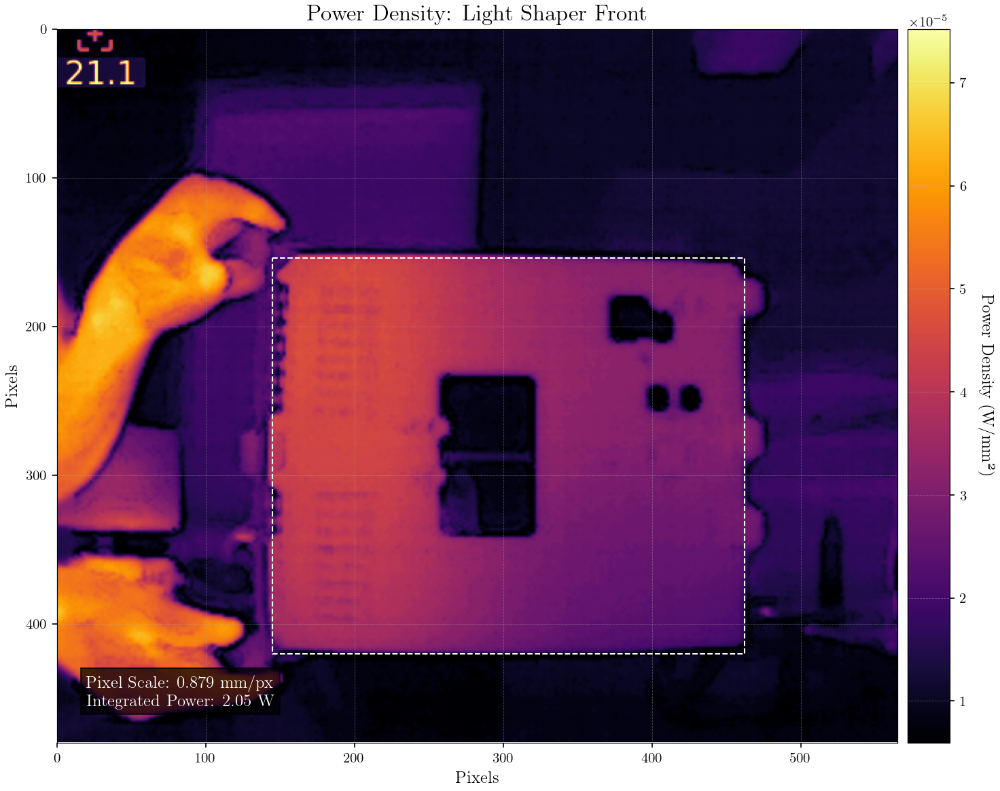

In [102]:
# --- Define Input Parameters ---
IMAGE_FILE = 'images/8.19.2025/lightshaper_front.jpg'
TEMP_RANGE_C = [21.1, 33.1] # Celsius
BOARD_DIMS_MM = [232.5, 280.0]  # [height, width]
Y_BOUNDS_PX = [154, 420]          # [top, bottom]
X_BOUNDS_PX = [145, 462]         # [left, right]
PLOT_TITLE = 'Light Shaper Front'
EMISSIVITY = 0.94
CONV = 10

# --- Run the Analysis ---
lightshaper_front_power = board_power(
    image_path=IMAGE_FILE,
    temp_range_c=TEMP_RANGE_C,
    board_dims_mm=BOARD_DIMS_MM,
    y_bounds_px=Y_BOUNDS_PX,
    x_bounds_px=X_BOUNDS_PX,
    plot_title=PLOT_TITLE,
    include_convection=False,
    emissivity=EMISSIVITY,
    h_convection=CONV
)

--- Pixel Scale Calculation ---
Y-axis scale: 0.8245 mm/px
X-axis scale: 0.8309 mm/px
Averaged scale: 0.8277 mm/px

--- Model Parameters ---
Emissivity (ε): 0.94
Convection included: False

--- Power Calculation Results ---
Region of Interest (pixels): Y=(138, 420), X=(145, 482)
-----------------------------------
Total Integrated Power: 2.5639 Watts
-----------------------------------


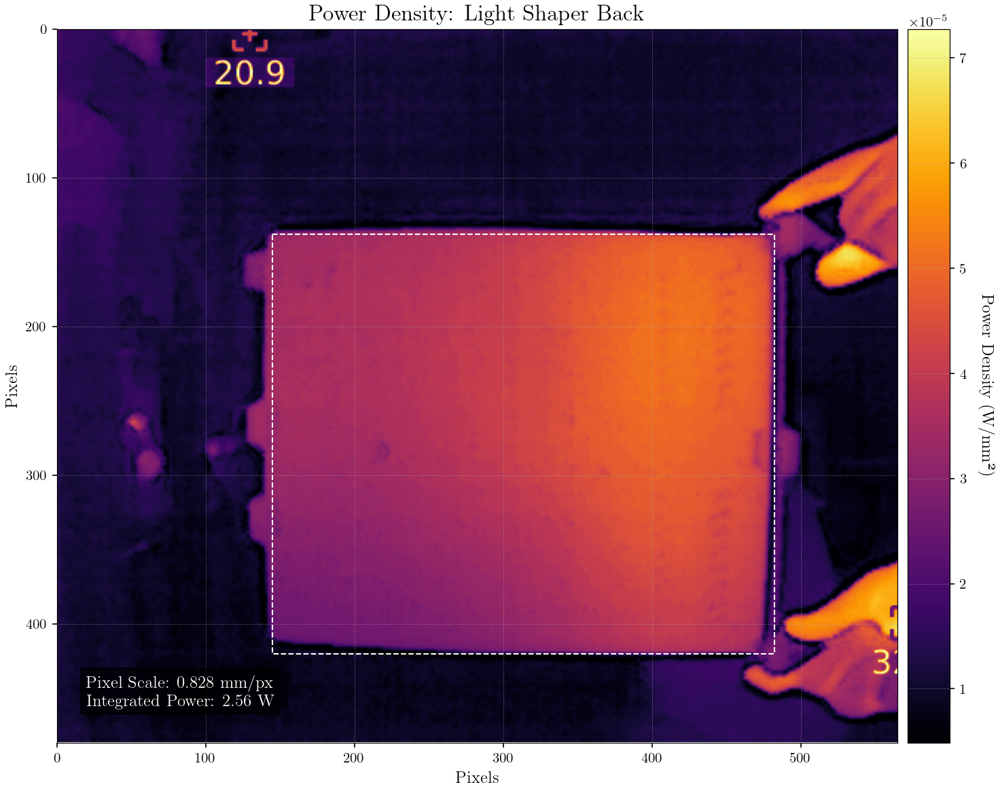

Total Light Shaper Power:  4.618595110581333 Watts


In [103]:
# --- Define Input Parameters ---
IMAGE_FILE = 'images/8.19.2025/lightshaper_back.jpg'
TEMP_RANGE_C = [20.9, 32.7] # Celsius
BOARD_DIMS_MM = [232.5, 280.0]  # [height, width]
Y_BOUNDS_PX = [138, 420]          # [top, bottom]
X_BOUNDS_PX = [145, 482]         # [left, right]
PLOT_TITLE = 'Light Shaper Back'
EMISSIVITY = 0.94
CONV = 10

# --- Run the Analysis ---
lightshaper_back_power = board_power(
    image_path=IMAGE_FILE,
    temp_range_c=TEMP_RANGE_C,
    board_dims_mm=BOARD_DIMS_MM,
    y_bounds_px=Y_BOUNDS_PX,
    x_bounds_px=X_BOUNDS_PX,
    plot_title=PLOT_TITLE,
    include_convection=False,
    emissivity=EMISSIVITY,
    h_convection=CONV
)

lightshaper_power = lightshaper_front_power + lightshaper_back_power
print("Total Light Shaper Power: ", lightshaper_power, 'Watts')

--- Pixel Scale Calculation ---
Y-axis scale: 0.8975 mm/px
X-axis scale: 0.9091 mm/px
Averaged scale: 0.9033 mm/px

--- Model Parameters ---
Emissivity (ε): 0.94
Convection included: False

--- Power Calculation Results ---
Region of Interest (pixels): Y=(60, 465), X=(164, 472)
-----------------------------------
Total Integrated Power: 3.3155 Watts
-----------------------------------


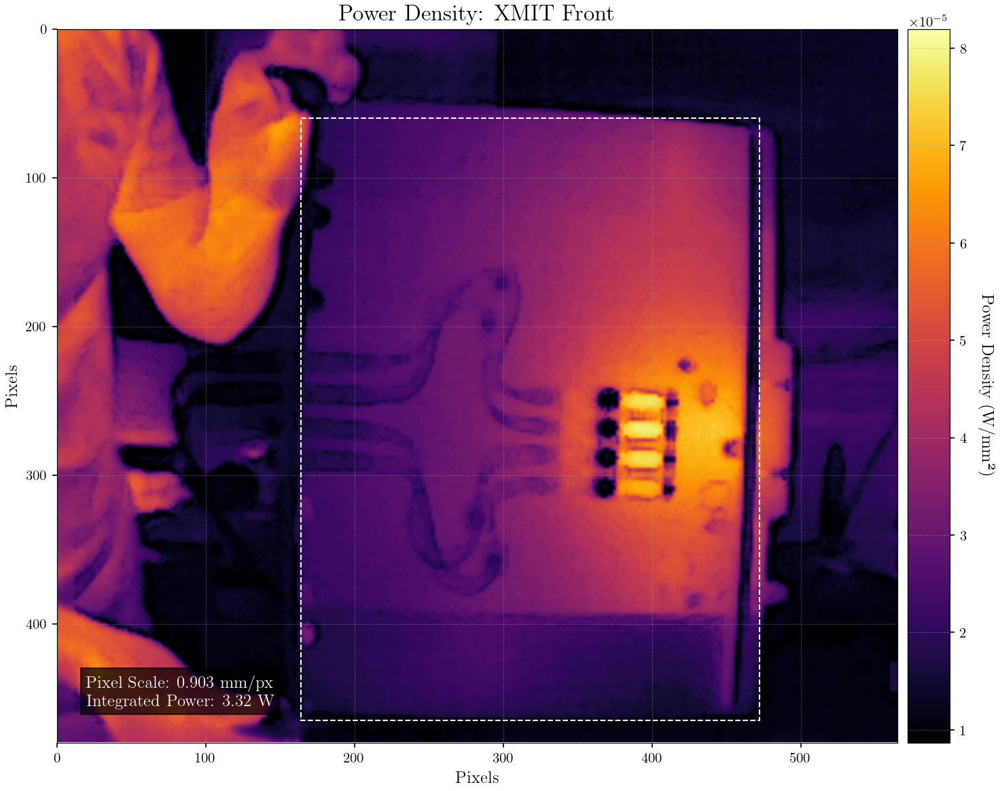

In [104]:
# --- Define Input Parameters ---
IMAGE_FILE = 'images/8.19.2025/xmit_front.jpg'
TEMP_RANGE_C = [21.6, 34.2] # Celsius
BOARD_DIMS_MM = [363.47, 280.0]  # [height, width]
Y_BOUNDS_PX = [60, 465]          # [top, bottom]
X_BOUNDS_PX = [164, 472]         # [left, right]
PLOT_TITLE = 'XMIT Front'
EMISSIVITY = 0.94
CONV = 10

# --- Run the Analysis ---
xmit_front_power = board_power(
    image_path=IMAGE_FILE,
    temp_range_c=TEMP_RANGE_C,
    board_dims_mm=BOARD_DIMS_MM,
    y_bounds_px=Y_BOUNDS_PX,
    x_bounds_px=X_BOUNDS_PX,
    plot_title=PLOT_TITLE,
    include_convection=False,
    emissivity=EMISSIVITY,
    h_convection=CONV
)

--- Pixel Scale Calculation ---
Y-axis scale: 0.9155 mm/px
X-axis scale: 0.8861 mm/px
Averaged scale: 0.9008 mm/px

--- Model Parameters ---
Emissivity (ε): 0.94
Convection included: False

--- Power Calculation Results ---
Region of Interest (pixels): Y=(48, 445), X=(184, 500)
-----------------------------------
Total Integrated Power: 3.4898 Watts
-----------------------------------


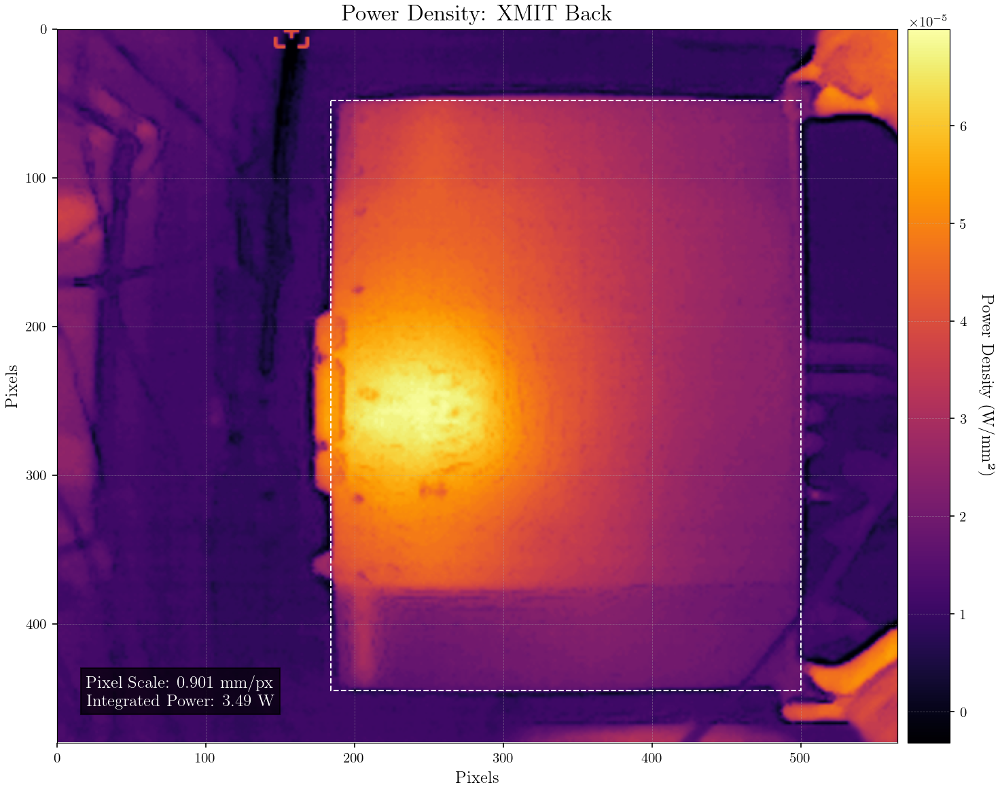

Total XMIT Power:  6.805280521188561 Watts


In [105]:
# --- Define Input Parameters ---
IMAGE_FILE = 'images/8.19.2025/xmit_back.jpg'
TEMP_RANGE_C = [19.4, 32.7] # Celsius
BOARD_DIMS_MM = [363.47, 280.0]  # [height, width]
Y_BOUNDS_PX = [48, 445]          # [top, bottom]
X_BOUNDS_PX = [184, 500]         # [left, right]
PLOT_TITLE = 'XMIT Back'
EMISSIVITY = 0.94
CONV = 10

# --- Run the Analysis ---
xmit_back_power = board_power(
    image_path=IMAGE_FILE,
    temp_range_c=TEMP_RANGE_C,
    board_dims_mm=BOARD_DIMS_MM,
    y_bounds_px=Y_BOUNDS_PX,
    x_bounds_px=X_BOUNDS_PX,
    plot_title=PLOT_TITLE,
    include_convection=False,
    emissivity=EMISSIVITY,
    h_convection=CONV
)

xmit_power = xmit_front_power + xmit_back_power
print("Total XMIT Power: ", xmit_power, 'Watts')

--- Pixel Scale Calculation ---
Y-axis scale: 0.6605 mm/px
X-axis scale: 0.6667 mm/px
Averaged scale: 0.6636 mm/px

--- Model Parameters ---
Emissivity (ε): 0.94
Convection included: False

--- Power Calculation Results ---
Region of Interest (pixels): Y=(90, 442), X=(130, 550)
-----------------------------------
Total Integrated Power: 2.4425 Watts
-----------------------------------


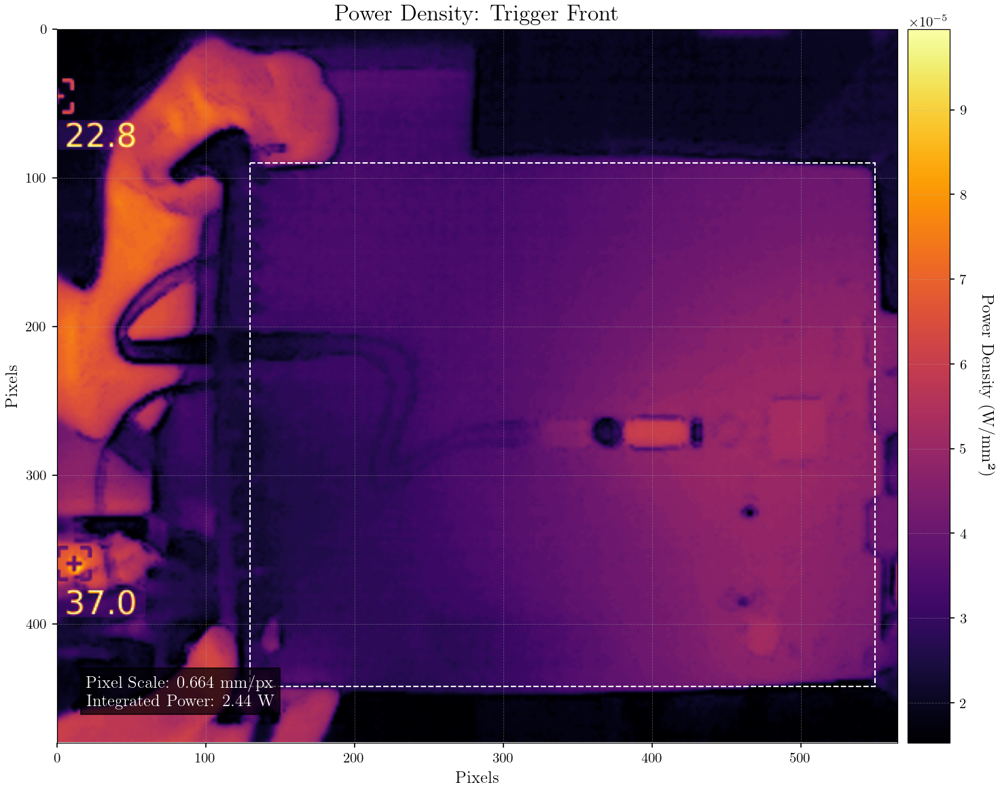

In [106]:
# --- Define Input Parameters ---
IMAGE_FILE = 'images/8.19.2025/trigger_front.jpg'
TEMP_RANGE_C = [22.8, 37.0] # Celsius
BOARD_DIMS_MM = [232.5, 280.0]  # [height, width]
Y_BOUNDS_PX = [90, 442]          # [top, bottom]
X_BOUNDS_PX = [130, 550]         # [left, right]
PLOT_TITLE = 'Trigger Front'
EMISSIVITY = 0.94
CONV = 10

# --- Run the Analysis ---
trigger_front_power = board_power(
    image_path=IMAGE_FILE,
    temp_range_c=TEMP_RANGE_C,
    board_dims_mm=BOARD_DIMS_MM,
    y_bounds_px=Y_BOUNDS_PX,
    x_bounds_px=X_BOUNDS_PX,
    plot_title=PLOT_TITLE,
    include_convection=False,
    emissivity=EMISSIVITY,
    h_convection=CONV
)

--- Pixel Scale Calculation ---
Y-axis scale: 1.0013 mm/px
X-axis scale: 0.6407 mm/px
Averaged scale: 0.8210 mm/px

--- Model Parameters ---
Emissivity (ε): 0.94
Convection included: False

--- Power Calculation Results ---
Region of Interest (pixels): Y=(72, 435), X=(108, 545)
-----------------------------------
Total Integrated Power: 3.2534 Watts
-----------------------------------


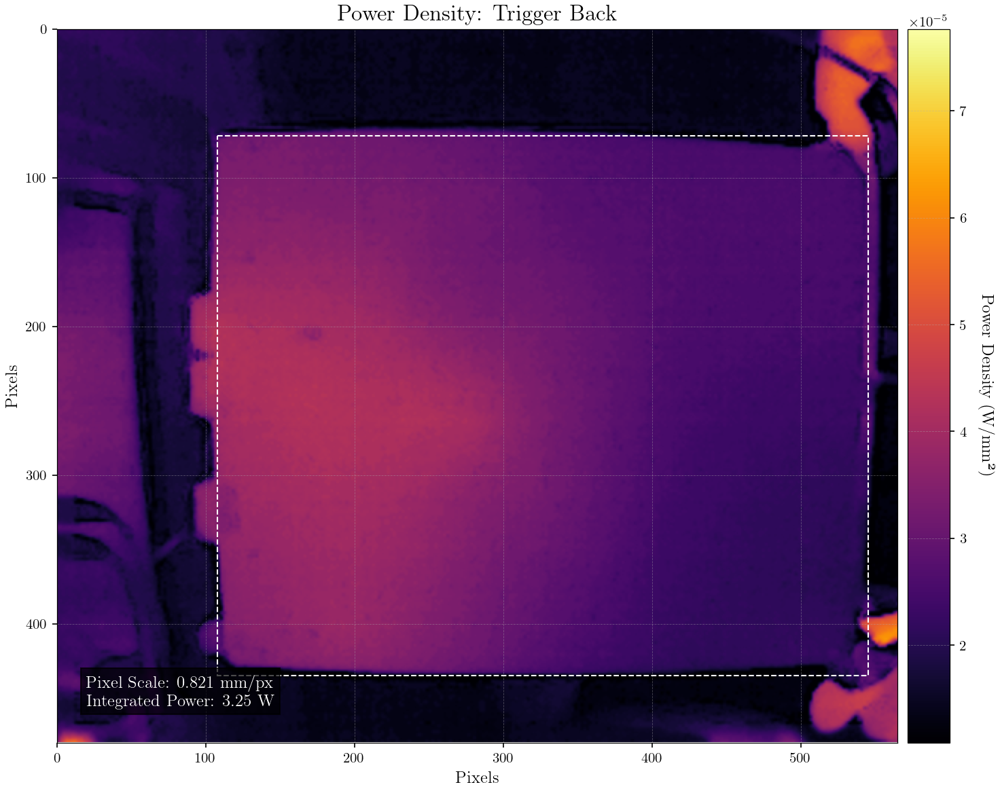

Total Trigger Power:  5.695903228899146 Watts


In [107]:
# --- Define Input Parameters ---
IMAGE_FILE = 'images/8.19.2025/trigger_back.jpg'
TEMP_RANGE_C = [22.0, 33.5] # Celsius
BOARD_DIMS_MM = [363.47, 280.0]  # [height, width]
Y_BOUNDS_PX = [72, 435]          # [top, bottom]
X_BOUNDS_PX = [108, 545]         # [left, right]
PLOT_TITLE = 'Trigger Back'
EMISSIVITY = 0.94
CONV = 10

# --- Run the Analysis ---
trigger_back_power = board_power(
    image_path=IMAGE_FILE,
    temp_range_c=TEMP_RANGE_C,
    board_dims_mm=BOARD_DIMS_MM,
    y_bounds_px=Y_BOUNDS_PX,
    x_bounds_px=X_BOUNDS_PX,
    plot_title=PLOT_TITLE,
    include_convection=False,
    emissivity=EMISSIVITY,
    h_convection=CONV
)

trigger_power = trigger_front_power + trigger_back_power
print("Total Trigger Power: ", trigger_power, 'Watts')

In [108]:
# sum of all board power:
total_power = lightfem_power + lightshaper_power + xmit_power + ctrl_power + (3*chargefem_power) + trigger_power
print(total_power)

# compute scale factor
actual_power = 106.90 # W
scale_factor = actual_power / total_power
print(scale_factor)

65.99917943854163
1.619717107233813


In [109]:
from IPython.display import Markdown, display
# scale all of the powers and print as nice markdown table
lightfem_power_scaled = scale_factor * lightfem_power
lightshaper_power_scaled = scale_factor * lightshaper_power
xmit_power_scaled = scale_factor * xmit_power
ctrl_power_scaled = scale_factor * ctrl_power
chargefem_power_scaled = scale_factor * chargefem_power
trigger_power_scaled = scale_factor * trigger_power

# create markdown table
table = f"""
| Component       | Power (W) |
|------------------|-----------|
| Light FEM        | {lightfem_power_scaled:.2f} |
| Light Shaper     | {lightshaper_power_scaled:.2f} |
| XMIT             | {xmit_power_scaled:.2f} |
| Ctrl             | {ctrl_power_scaled:.2f} |
| Charge FEM (x3)  | {3*chargefem_power_scaled:.2f} |
| Trigger          | {trigger_power_scaled:.2f} |
| **Total**        | **{actual_power:.2f}** |
"""

display(Markdown(table))


| Component       | Power (W) |
|------------------|-----------|
| Light FEM        | 16.98 |
| Light Shaper     | 7.48 |
| XMIT             | 11.02 |
| Ctrl             | 6.82 |
| Charge FEM (x3)  | 55.37 |
| Trigger          | 9.23 |
| **Total**        | **106.90** |


--- Pixel Scale Calculation ---
Y-axis scale: 0.9344 mm/px
X-axis scale: 0.9032 mm/px
Averaged scale: 0.9188 mm/px

--- Model Parameters ---
Emissivity (ε): 0.94
Convection included: False

--- Power Calculation Results ---
Region of Interest (pixels): Y=(60, 449), X=(175, 485)
-----------------------------------
Total Integrated Power: 8.5365 Watts
-----------------------------------


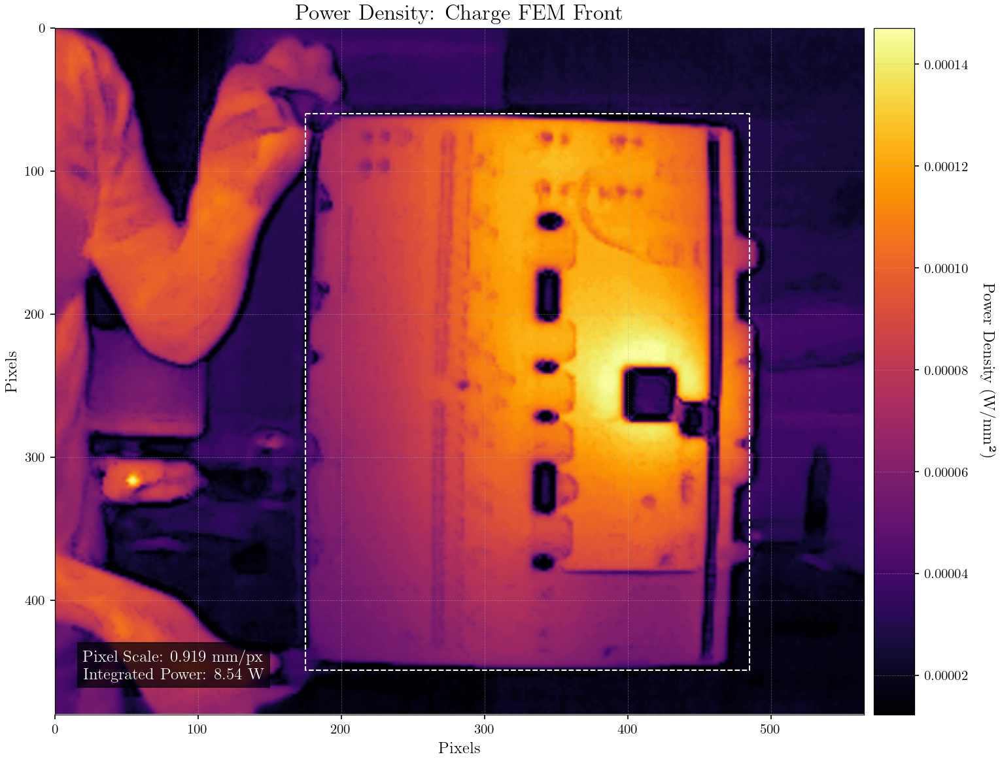

In [110]:
# rerun all plots with scale:
IMAGE_FILE = 'images/8.19.2025/chargefem_front.jpg'
TEMP_RANGE_C = [21.4, 36.2]
BOARD_DIMS_MM = [363.47, 280.0]  # [height, width]
Y_BOUNDS_PX = [60, 449]          # [top, bottom]
X_BOUNDS_PX = [175, 485]         # [left, right]
PLOT_TITLE = 'Charge FEM Front'
EMISSIVITY = 0.94
CONV = 10
SCALE = scale_factor


# --- Run the Analysis ---
chargefem_front_power = board_power(
    image_path=IMAGE_FILE,
    temp_range_c=TEMP_RANGE_C,
    board_dims_mm=BOARD_DIMS_MM,
    y_bounds_px=Y_BOUNDS_PX,
    x_bounds_px=X_BOUNDS_PX,
    plot_title=PLOT_TITLE,
    emissivity=EMISSIVITY,
    include_convection=False,
    h_convection=CONV,
    scale=SCALE
)

--- Pixel Scale Calculation ---
Y-axis scale: 0.8822 mm/px
X-axis scale: 0.8284 mm/px
Averaged scale: 0.8553 mm/px

--- Model Parameters ---
Emissivity (ε): 0.94
Convection included: False

--- Power Calculation Results ---
Region of Interest (pixels): Y=(44, 456), X=(142, 480)
-----------------------------------
Total Integrated Power: 9.9186 Watts
-----------------------------------


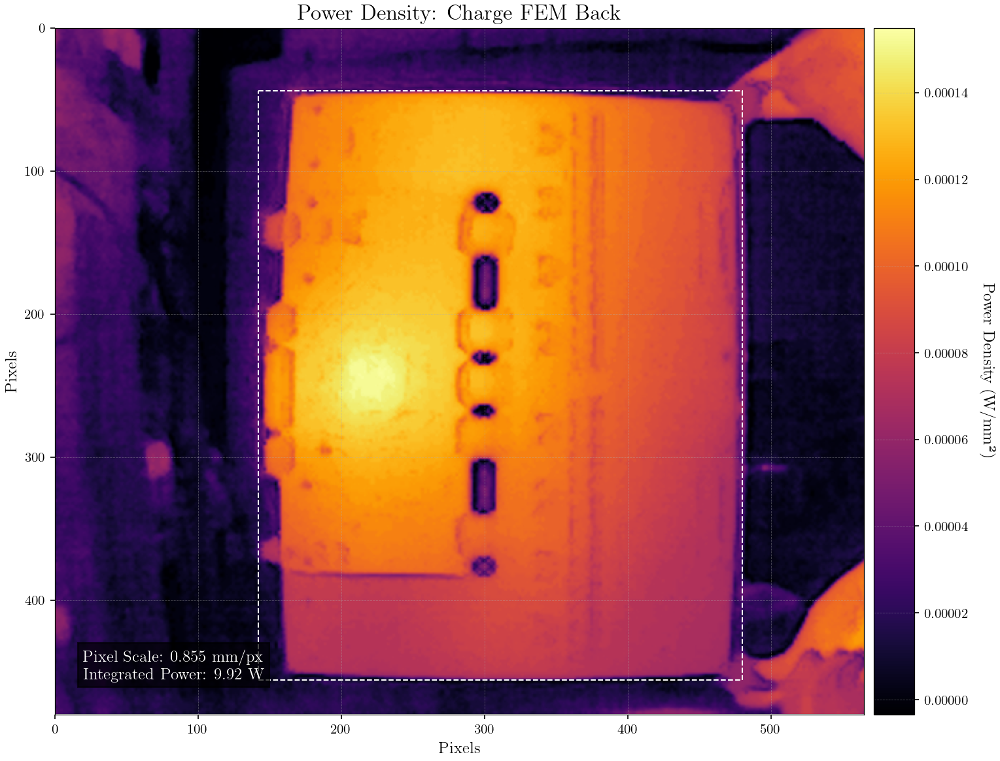

Total Charge FEM Power:  18.455175399584114 Watts


In [111]:
# --- Define Input Parameters ---
IMAGE_FILE = 'images/8.19.2025/chargefem_back.jpg'
TEMP_RANGE_C = [19.6, 37.0] # Celsius
BOARD_DIMS_MM = [363.47, 280.0]  # [height, width]
Y_BOUNDS_PX = [44, 456]          # [top, bottom]
X_BOUNDS_PX = [142, 480]         # [left, right]
PLOT_TITLE = 'Charge FEM Back'
EMISSIVITY = 0.94
CONV = 10
SCALE = scale_factor

# --- Run the Analysis ---
chargefem_back_power = board_power(
    image_path=IMAGE_FILE,
    temp_range_c=TEMP_RANGE_C,
    board_dims_mm=BOARD_DIMS_MM,
    y_bounds_px=Y_BOUNDS_PX,
    x_bounds_px=X_BOUNDS_PX,
    plot_title=PLOT_TITLE,
    emissivity=EMISSIVITY,
    include_convection=False,
    h_convection=CONV,
    scale=SCALE
)

chargefem_power = chargefem_front_power + chargefem_back_power
print("Total Charge FEM Power: ", chargefem_power, 'Watts')

--- Pixel Scale Calculation ---
Y-axis scale: 0.7003 mm/px
X-axis scale: 0.6829 mm/px
Averaged scale: 0.6916 mm/px

--- Model Parameters ---
Emissivity (ε): 0.94
Convection included: False

--- Power Calculation Results ---
Region of Interest (pixels): Y=(88, 420), X=(105, 515)
-----------------------------------
Total Integrated Power: 8.3797 Watts
-----------------------------------


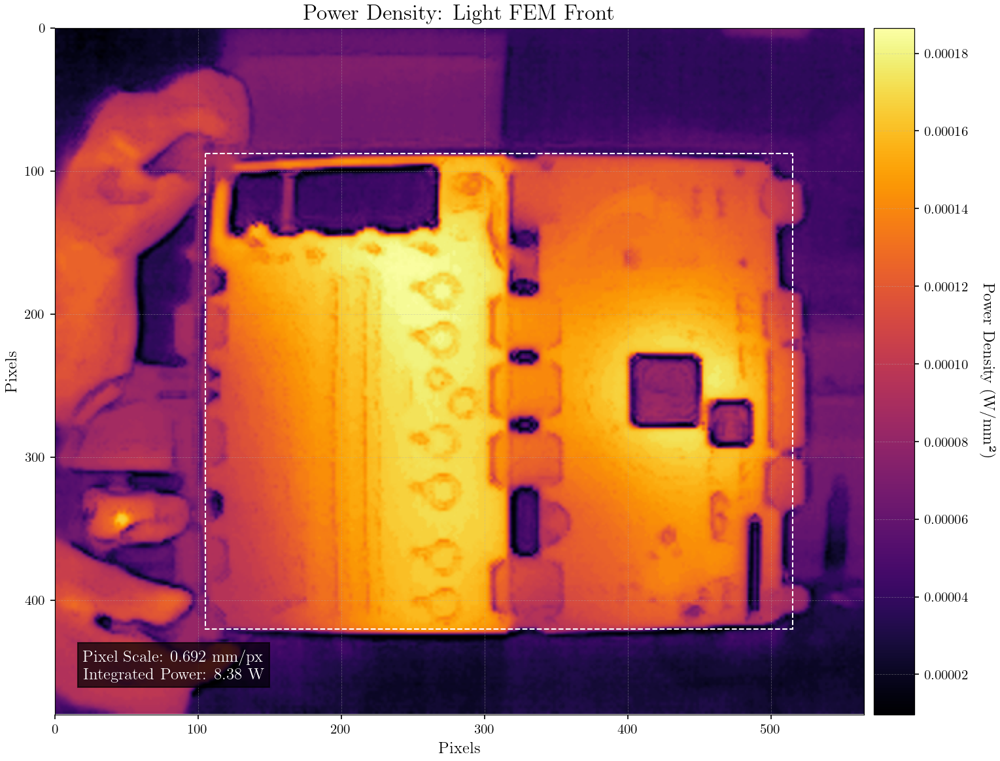

In [112]:
# --- Define Input Parameters ---
IMAGE_FILE = 'images/8.19.2025/lightfem_front.jpg'
TEMP_RANGE_C = [21.1, 40.1] # Celsius
BOARD_DIMS_MM = [232.5, 280.0]  # [height, width]
Y_BOUNDS_PX = [88, 420]          # [top, bottom]
X_BOUNDS_PX = [105, 515]         # [left, right]
PLOT_TITLE = 'Light FEM Front'
EMISSIVITY = 0.94
CONV = 10
SCALE = scale_factor

# --- Run the Analysis ---
lightfem_front_power = board_power(
    image_path=IMAGE_FILE,
    temp_range_c=TEMP_RANGE_C,
    board_dims_mm=BOARD_DIMS_MM,
    y_bounds_px=Y_BOUNDS_PX,
    x_bounds_px=X_BOUNDS_PX,
    plot_title=PLOT_TITLE,
    include_convection=False,
    emissivity=EMISSIVITY,
    h_convection=CONV,
    scale=SCALE
)

--- Pixel Scale Calculation ---
Y-axis scale: 0.7003 mm/px
X-axis scale: 0.6829 mm/px
Averaged scale: 0.6916 mm/px

--- Model Parameters ---
Emissivity (ε): 0.94
Convection included: False

--- Power Calculation Results ---
Region of Interest (pixels): Y=(88, 420), X=(105, 515)
-----------------------------------
Total Integrated Power: 8.6665 Watts
-----------------------------------


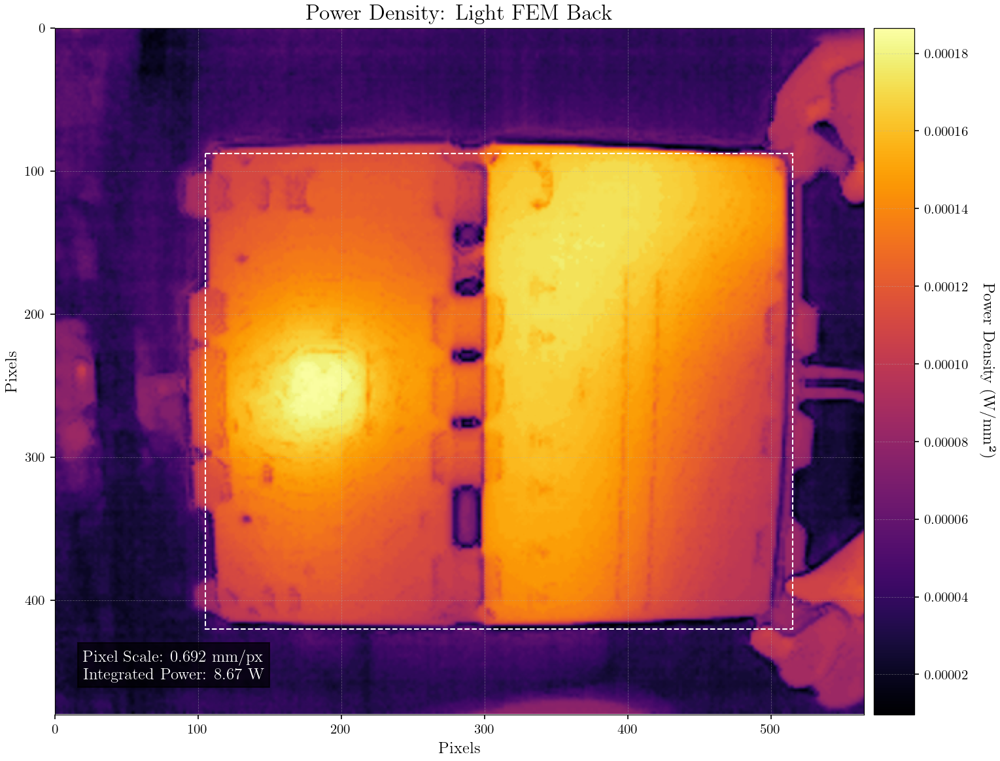

Total Light FEM Power:  17.046179106362807 Watts


In [113]:
# --- Define Input Parameters ---
IMAGE_FILE = 'images/8.19.2025/lightfem_back.jpg'
TEMP_RANGE_C = [21.1, 40.1] # Celsius
BOARD_DIMS_MM = [232.5, 280.0]  # [height, width]
Y_BOUNDS_PX = [88, 420]          # [top, bottom]
X_BOUNDS_PX = [105, 515]         # [left, right]
PLOT_TITLE = 'Light FEM Back'
EMISSIVITY = 0.94
CONV = 10
SCALE = scale_factor

# --- Run the Analysis ---
lightfem_back_power = board_power(
    image_path=IMAGE_FILE,
    temp_range_c=TEMP_RANGE_C,
    board_dims_mm=BOARD_DIMS_MM,
    y_bounds_px=Y_BOUNDS_PX,
    x_bounds_px=X_BOUNDS_PX,
    plot_title=PLOT_TITLE,
    include_convection=False,
    emissivity=EMISSIVITY,
    h_convection=CONV,
    scale=SCALE
)

lightfem_power = lightfem_front_power + lightfem_back_power
print("Total Light FEM Power: ", lightfem_power, 'Watts')

--- Pixel Scale Calculation ---
Y-axis scale: 0.8741 mm/px
X-axis scale: 0.8833 mm/px
Averaged scale: 0.8787 mm/px

--- Model Parameters ---
Emissivity (ε): 0.94
Convection included: False

--- Power Calculation Results ---
Region of Interest (pixels): Y=(154, 420), X=(145, 462)
-----------------------------------
Total Integrated Power: 3.3280 Watts
-----------------------------------


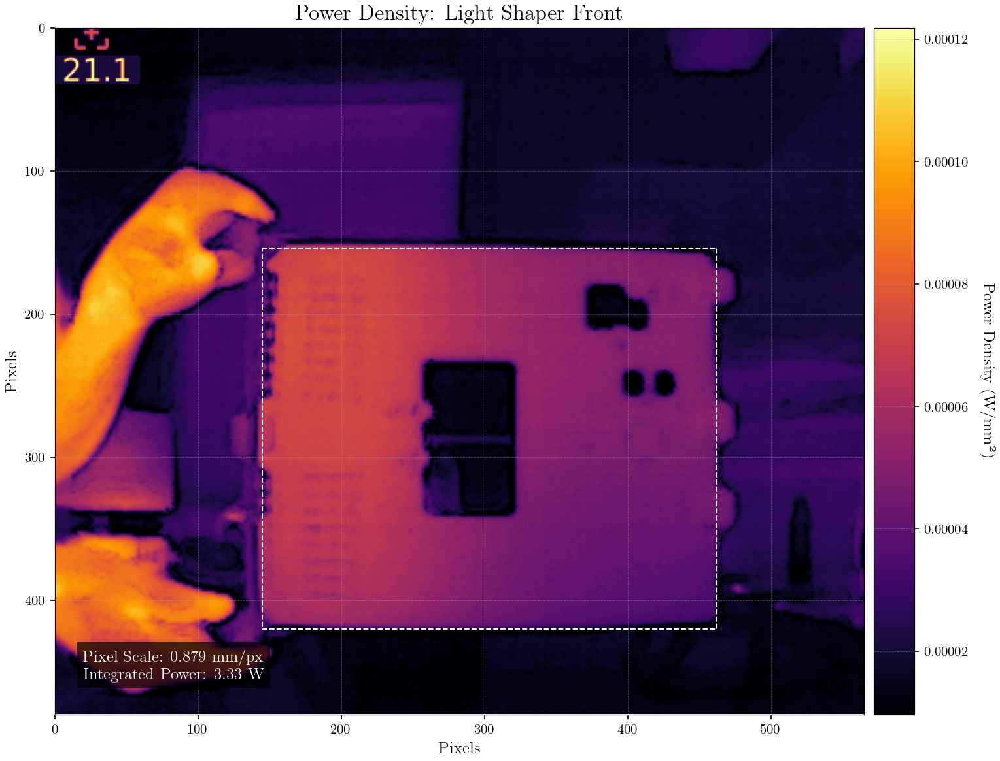

In [114]:
# --- Define Input Parameters ---
IMAGE_FILE = 'images/8.19.2025/lightshaper_front.jpg'
TEMP_RANGE_C = [21.1, 33.1] # Celsius
BOARD_DIMS_MM = [232.5, 280.0]  # [height, width]
Y_BOUNDS_PX = [154, 420]          # [top, bottom]
X_BOUNDS_PX = [145, 462]         # [left, right]
PLOT_TITLE = 'Light Shaper Front'
EMISSIVITY = 0.94
CONV = 10
SCALE = scale_factor

# --- Run the Analysis ---
lightshaper_front_power = board_power(
    image_path=IMAGE_FILE,
    temp_range_c=TEMP_RANGE_C,
    board_dims_mm=BOARD_DIMS_MM,
    y_bounds_px=Y_BOUNDS_PX,
    x_bounds_px=X_BOUNDS_PX,
    plot_title=PLOT_TITLE,
    include_convection=False,
    emissivity=EMISSIVITY,
    h_convection=CONV,
    scale=SCALE
)

--- Pixel Scale Calculation ---
Y-axis scale: 0.8245 mm/px
X-axis scale: 0.8309 mm/px
Averaged scale: 0.8277 mm/px

--- Model Parameters ---
Emissivity (ε): 0.94
Convection included: False

--- Power Calculation Results ---
Region of Interest (pixels): Y=(138, 420), X=(145, 482)
-----------------------------------
Total Integrated Power: 4.1528 Watts
-----------------------------------


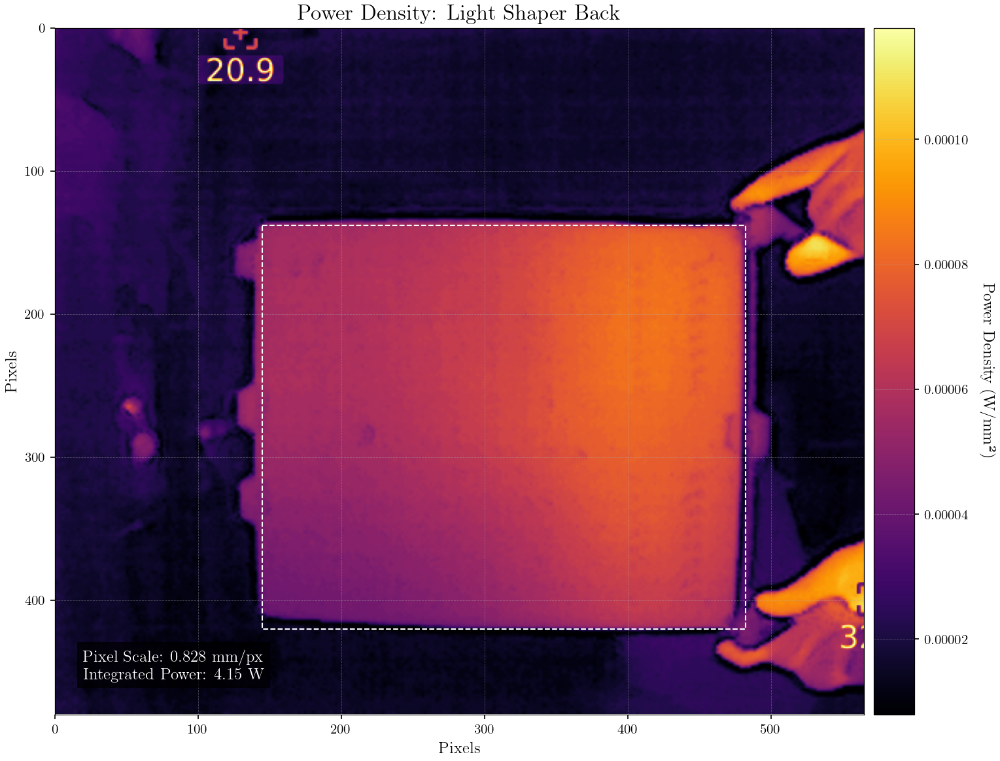

Total Light Shaper Power:  7.4808175119950295 Watts


In [115]:
# --- Define Input Parameters ---
IMAGE_FILE = 'images/8.19.2025/lightshaper_back.jpg'
TEMP_RANGE_C = [20.9, 32.7] # Celsius
BOARD_DIMS_MM = [232.5, 280.0]  # [height, width]
Y_BOUNDS_PX = [138, 420]          # [top, bottom]
X_BOUNDS_PX = [145, 482]         # [left, right]
PLOT_TITLE = 'Light Shaper Back'
EMISSIVITY = 0.94
CONV = 10
SCALE = scale_factor

# --- Run the Analysis ---
lightshaper_back_power = board_power(
    image_path=IMAGE_FILE,
    temp_range_c=TEMP_RANGE_C,
    board_dims_mm=BOARD_DIMS_MM,
    y_bounds_px=Y_BOUNDS_PX,
    x_bounds_px=X_BOUNDS_PX,
    plot_title=PLOT_TITLE,
    include_convection=False,
    emissivity=EMISSIVITY,
    h_convection=CONV,
    scale=SCALE
)

lightshaper_power = lightshaper_front_power + lightshaper_back_power
print("Total Light Shaper Power: ", lightshaper_power, 'Watts')

--- Pixel Scale Calculation ---
Y-axis scale: 0.8975 mm/px
X-axis scale: 0.9091 mm/px
Averaged scale: 0.9033 mm/px

--- Model Parameters ---
Emissivity (ε): 0.94
Convection included: False

--- Power Calculation Results ---
Region of Interest (pixels): Y=(60, 465), X=(164, 472)
-----------------------------------
Total Integrated Power: 5.3702 Watts
-----------------------------------


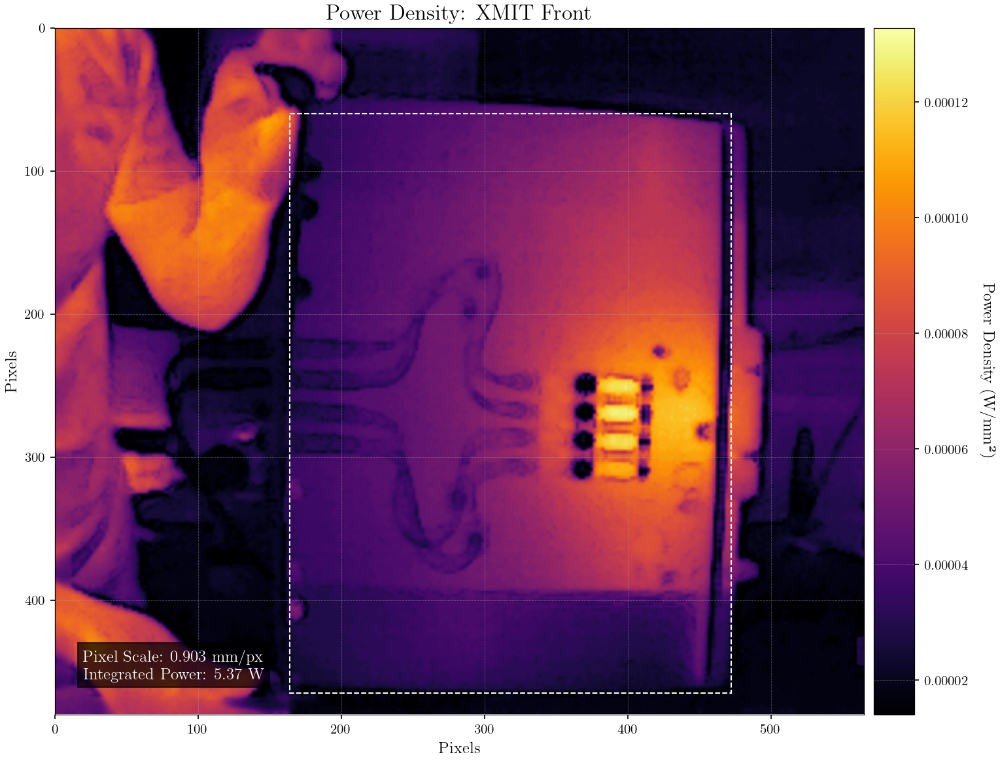

In [116]:
# --- Define Input Parameters ---
IMAGE_FILE = 'images/8.19.2025/xmit_front.jpg'
TEMP_RANGE_C = [21.6, 34.2] # Celsius
BOARD_DIMS_MM = [363.47, 280.0]  # [height, width]
Y_BOUNDS_PX = [60, 465]          # [top, bottom]
X_BOUNDS_PX = [164, 472]         # [left, right]
PLOT_TITLE = 'XMIT Front'
EMISSIVITY = 0.94
CONV = 10
SCALE = scale_factor

# --- Run the Analysis ---
xmit_front_power = board_power(
    image_path=IMAGE_FILE,
    temp_range_c=TEMP_RANGE_C,
    board_dims_mm=BOARD_DIMS_MM,
    y_bounds_px=Y_BOUNDS_PX,
    x_bounds_px=X_BOUNDS_PX,
    plot_title=PLOT_TITLE,
    include_convection=False,
    emissivity=EMISSIVITY,
    h_convection=CONV,
    scale=SCALE
)

--- Pixel Scale Calculation ---
Y-axis scale: 0.9155 mm/px
X-axis scale: 0.8861 mm/px
Averaged scale: 0.9008 mm/px

--- Model Parameters ---
Emissivity (ε): 0.94
Convection included: False

--- Power Calculation Results ---
Region of Interest (pixels): Y=(48, 445), X=(184, 500)
-----------------------------------
Total Integrated Power: 5.6524 Watts
-----------------------------------


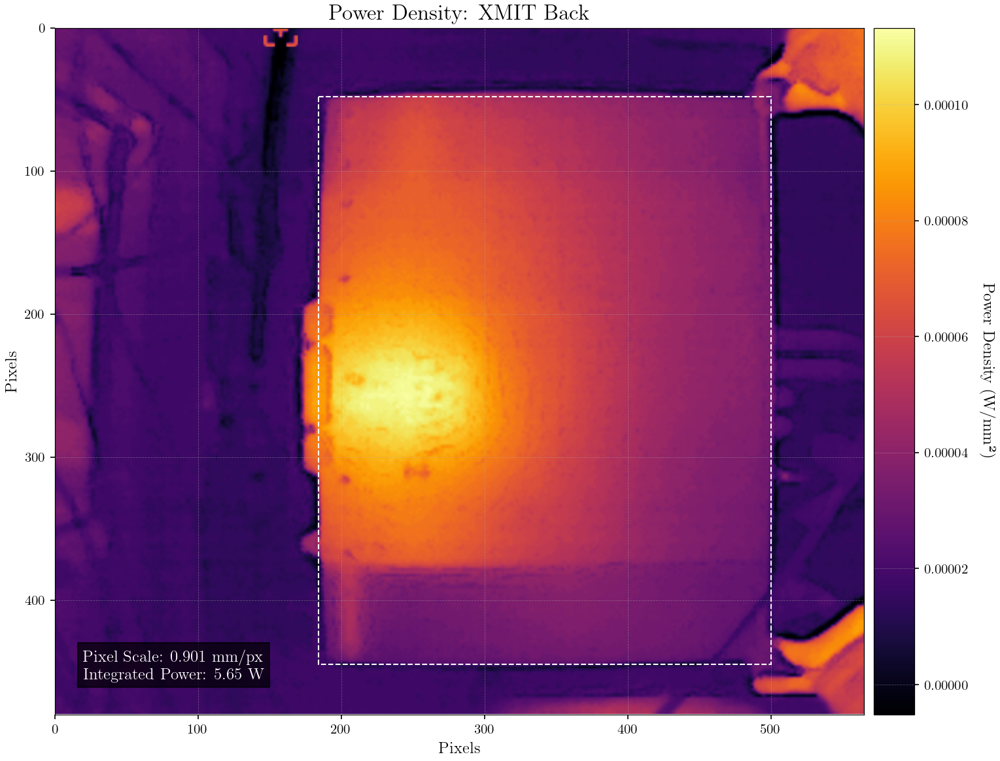

Total XMIT Power:  11.02262927969415 Watts


In [117]:
# --- Define Input Parameters ---
IMAGE_FILE = 'images/8.19.2025/xmit_back.jpg'
TEMP_RANGE_C = [19.4, 32.7] # Celsius
BOARD_DIMS_MM = [363.47, 280.0]  # [height, width]
Y_BOUNDS_PX = [48, 445]          # [top, bottom]
X_BOUNDS_PX = [184, 500]         # [left, right]
PLOT_TITLE = 'XMIT Back'
EMISSIVITY = 0.94
CONV = 10
SCALE = scale_factor

# --- Run the Analysis ---
xmit_back_power = board_power(
    image_path=IMAGE_FILE,
    temp_range_c=TEMP_RANGE_C,
    board_dims_mm=BOARD_DIMS_MM,
    y_bounds_px=Y_BOUNDS_PX,
    x_bounds_px=X_BOUNDS_PX,
    plot_title=PLOT_TITLE,
    include_convection=False,
    emissivity=EMISSIVITY,
    h_convection=CONV,
    scale=SCALE
)

xmit_power = xmit_front_power + xmit_back_power
print("Total XMIT Power: ", xmit_power, 'Watts')

--- Pixel Scale Calculation ---
Y-axis scale: 0.6605 mm/px
X-axis scale: 0.6667 mm/px
Averaged scale: 0.6636 mm/px

--- Model Parameters ---
Emissivity (ε): 0.94
Convection included: False

--- Power Calculation Results ---
Region of Interest (pixels): Y=(90, 442), X=(130, 550)
-----------------------------------
Total Integrated Power: 3.9561 Watts
-----------------------------------


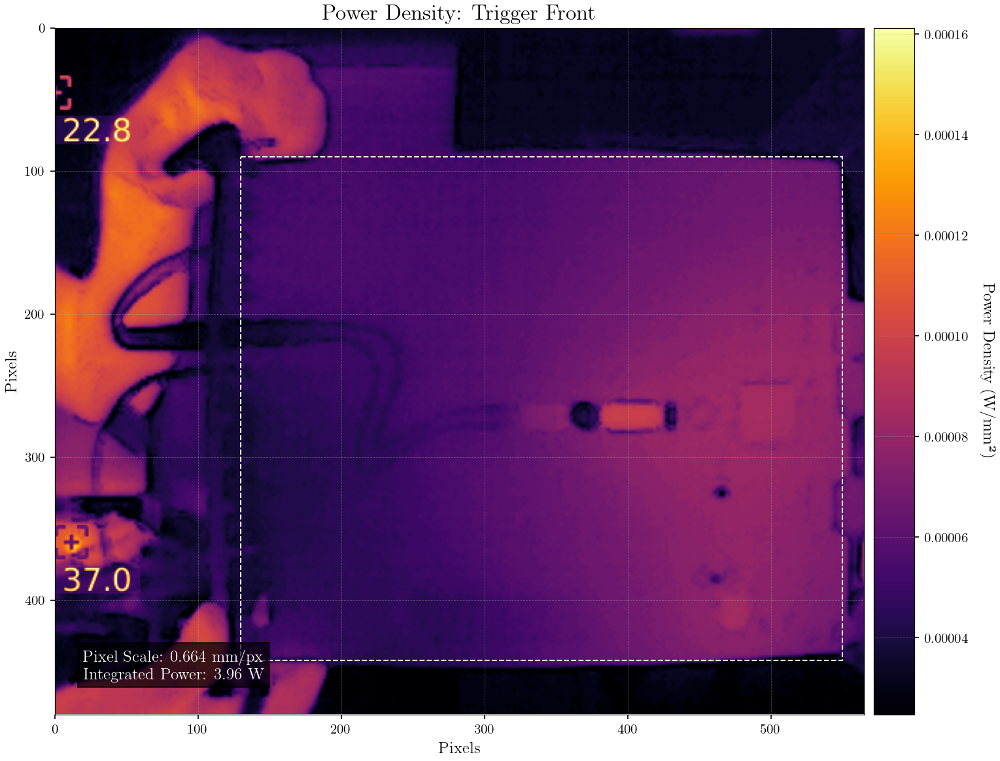

In [119]:
# --- Define Input Parameters ---
IMAGE_FILE = 'images/8.19.2025/trigger_front.jpg'
TEMP_RANGE_C = [22.8, 37.0] # Celsius
BOARD_DIMS_MM = [232.5, 280.0]  # [height, width]
Y_BOUNDS_PX = [90, 442]          # [top, bottom]
X_BOUNDS_PX = [130, 550]        # [left, right]
PLOT_TITLE = 'Trigger Front'
EMISSIVITY = 0.94
CONV = 10
SCALE = scale_factor

# --- Run the Analysis ---
trigger_front_power = board_power(
    image_path=IMAGE_FILE,
    temp_range_c=TEMP_RANGE_C,
    board_dims_mm=BOARD_DIMS_MM,
    y_bounds_px=Y_BOUNDS_PX,
    x_bounds_px=X_BOUNDS_PX,
    plot_title=PLOT_TITLE,
    include_convection=False,
    emissivity=EMISSIVITY,
    h_convection=CONV,
    scale=SCALE
)

--- Pixel Scale Calculation ---
Y-axis scale: 1.0013 mm/px
X-axis scale: 0.6407 mm/px
Averaged scale: 0.8210 mm/px

--- Model Parameters ---
Emissivity (ε): 0.94
Convection included: False

--- Power Calculation Results ---
Region of Interest (pixels): Y=(72, 435), X=(108, 545)
-----------------------------------
Total Integrated Power: 5.2696 Watts
-----------------------------------


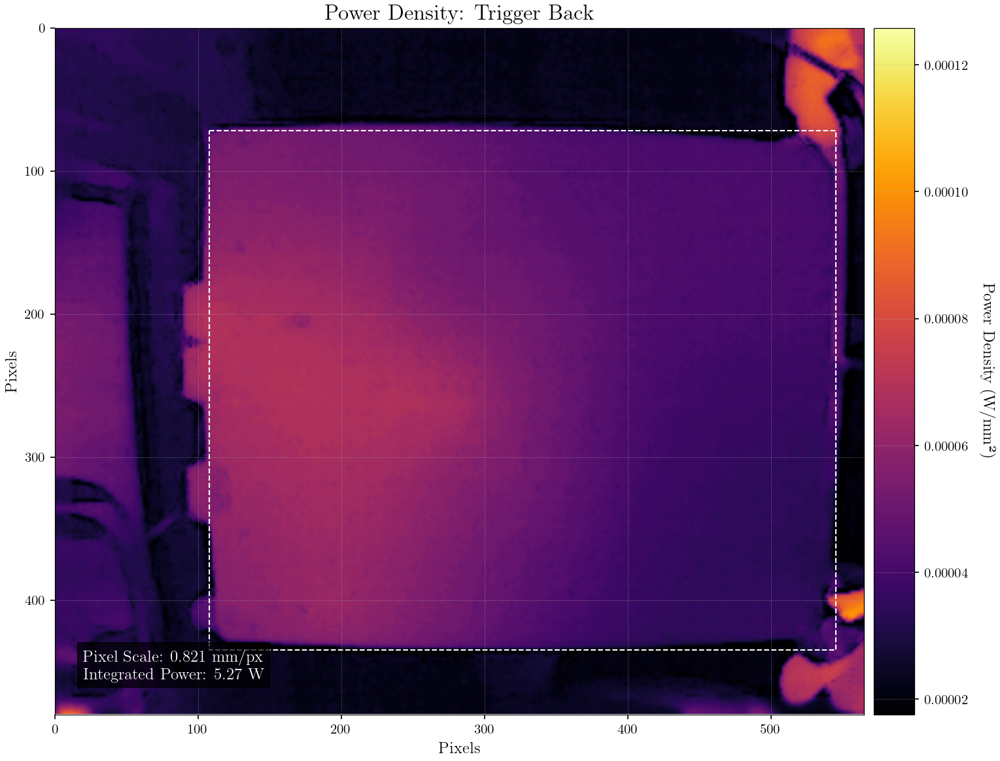

Total Trigger Power:  9.225751900996261 Watts


In [120]:
# --- Define Input Parameters ---
IMAGE_FILE = 'images/8.19.2025/trigger_back.jpg'
TEMP_RANGE_C = [22.0, 33.5] # Celsius
BOARD_DIMS_MM = [363.47, 280.0]  # [height, width]
Y_BOUNDS_PX = [72, 435]          # [top, bottom]
X_BOUNDS_PX = [108, 545]         # [left, right]
PLOT_TITLE = 'Trigger Back'
EMISSIVITY = 0.94
CONV = 10
SCALE = scale_factor

# --- Run the Analysis ---
trigger_back_power = board_power(
    image_path=IMAGE_FILE,
    temp_range_c=TEMP_RANGE_C,
    board_dims_mm=BOARD_DIMS_MM,
    y_bounds_px=Y_BOUNDS_PX,
    x_bounds_px=X_BOUNDS_PX,
    plot_title=PLOT_TITLE,
    include_convection=False,
    emissivity=EMISSIVITY,
    h_convection=CONV,
    scale=SCALE
)

trigger_power = trigger_front_power + trigger_back_power
print("Total Trigger Power: ", trigger_power, 'Watts')

--- Pixel Scale Calculation ---
Y-axis scale: 0.6838 mm/px
X-axis scale: 0.6747 mm/px
Averaged scale: 0.6793 mm/px

--- Model Parameters ---
Emissivity (ε): 0.94
Convection included: False

--- Power Calculation Results ---
Region of Interest (pixels): Y=(70, 410), X=(110, 525)
-----------------------------------
Total Integrated Power: 3.6883 Watts
-----------------------------------


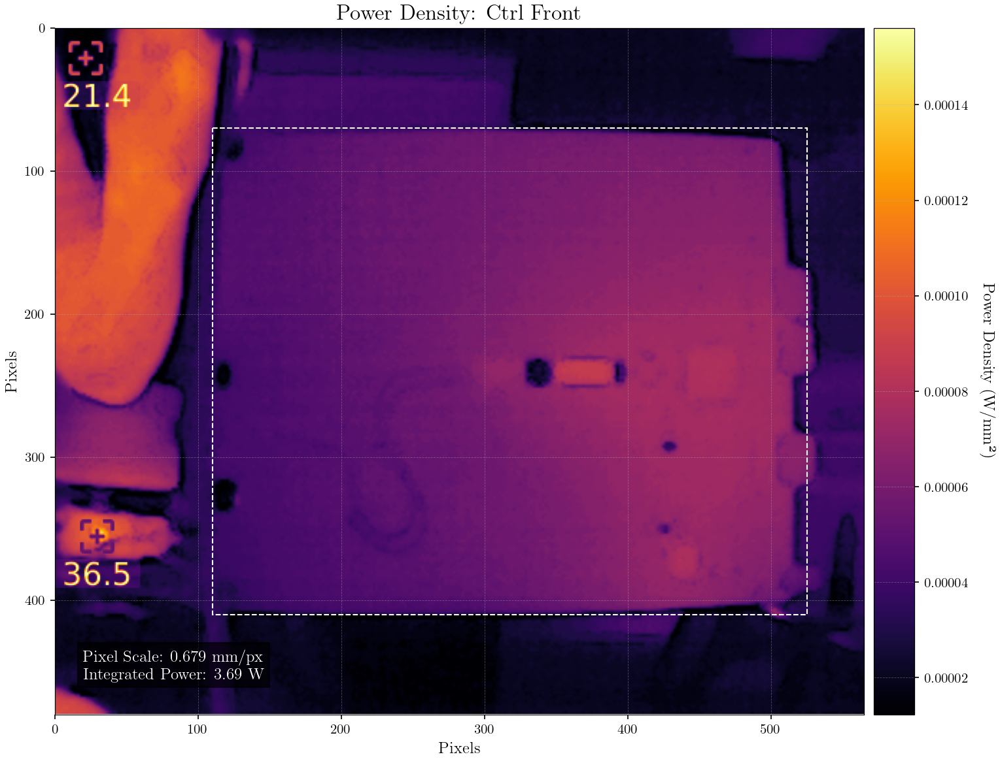

In [121]:
# --- Define Input Parameters ---
IMAGE_FILE = 'images/8.19.2025/ctrl_front.jpg'
TEMP_RANGE_C = [21.4, 36.5] # Celsius
BOARD_DIMS_MM = [232.5, 280.0]  # [height, width]
Y_BOUNDS_PX = [70, 410]          # [top, bottom]
X_BOUNDS_PX = [110, 525]         # [left, right]
PLOT_TITLE = 'Ctrl Front'
EMISSIVITY = 0.94
CONV = 10

# --- Run the Analysis ---
ctrl_front_power = board_power(
    image_path=IMAGE_FILE,
    temp_range_c=TEMP_RANGE_C,
    board_dims_mm=BOARD_DIMS_MM,
    y_bounds_px=Y_BOUNDS_PX,
    x_bounds_px=X_BOUNDS_PX,
    plot_title=PLOT_TITLE,
    include_convection=False,
    emissivity=EMISSIVITY,
    h_convection=CONV,
    scale=SCALE
)